# Program 4.11: Averages for differential adhesion growing

This program was developed for the master's thesis “Agent-based modelling of embryonic organoid development” (Víctor Villegas-Morral, 2024) using [CellBasedModels.jl](https://github.com/dsb-lab/CellBasedModels.jl).

The report and the rest of the code can be found on the [Multiscale Physics of Living Systems Group’s GitHub](https://github.com/MPoLS-lab) and on [my personal GitHub](https://github.com/villegas-morral/masters-thesis).

In [ ]:
using NBInclude

In [ ]:
@nbinclude("preamble/packages.ipynb");

In [ ]:
@nbinclude("preamble/functions.ipynb");

# Proportions over time for b = 0.2, adh = 5, same proliferation

## Model

In [ ]:
@nbinclude("preamble/model.ipynb");

## Initialization

In [ ]:
parameters = define_par();
dt = 0.002;
save_each = round(Int64, 0.25 / dt);

Random.seed!(2345)
n_cells = 60;

In [ ]:
ite  = 7
tf = 30;

In [ ]:
com = initialize_growth(parameters; dt=dt);
grow_size!(com, save_each, n_cells)
m0 = length(com);
println(formed_correctly(com))

In [ ]:
growncom = deepcopy(com);

## Proportions over time

In [ ]:
com_aux = deepcopy(growncom);

In [ ]:
adh  = 5
com.adh = [1 1 1; 1 adh 1; 1 1 1];
setfield!(com_aux,:dt, 0.001);
com_aux.tau_div = 10;

### Loop

fp = 5
kp_on = 20
kp_off = 10
true
Plot 1: timestamp 114
Plot 2: timestamp 194
Plot 3: timestamp 274
Plot 4: timestamp 354


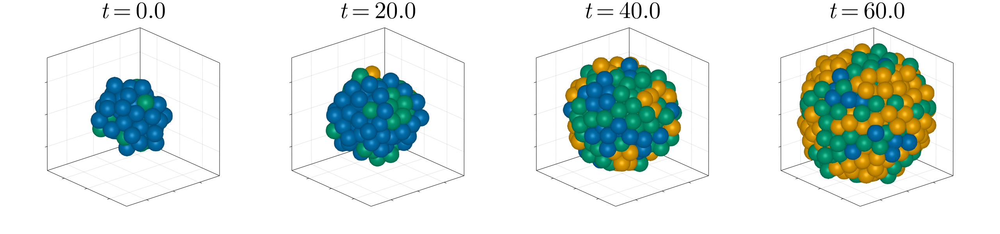

Plot 1: timestamp 114
Plot 2: timestamp 194
Plot 3: timestamp 274
Plot 4: timestamp 354


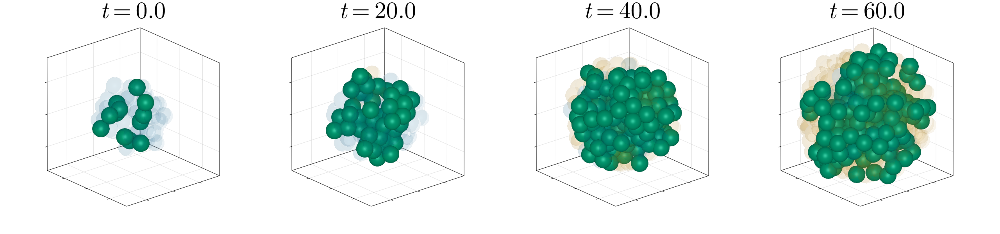

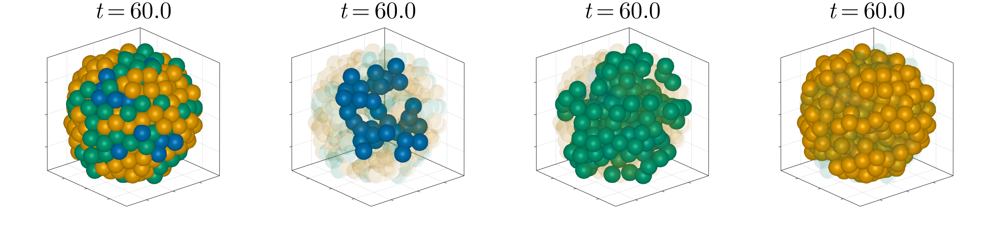

GLMakie.Screen(...)

In [12]:
	Random.seed!(1234)

	com = deepcopy(com_aux)
	initialize_diff!(com, g_on = true)
    global m1 = length(com)
    
	differentiate_growing!(com, save_each, tf, fp=5)
    println(formed_correctly(com))
	global m2 = length(com)

    dimensionalize_com!(com)

    plot_aggregate(com, color_map, m1, m2, size=35, shownumbers=false, showtime = true)
    plot_state(com, color_map, m1, m2; state=2,size=35, shownumbers=false, showtime = true)
    plot_state_timestamp(com, color_map, m2, size=35, showtime = true, shownumbers=false)

In [ ]:
Random.seed!(1234)
seeds = rand(1:2000, ite)
props = Dict();

In [ ]:
bad = 0
for i in 1:ite
	seed = seeds[i]
	print("Seed $i/$ite = $seed ...")
	Random.seed!(seed)

	com = deepcopy(com_aux)
	initialize_diff!(com, g_on = true)
    global m1 = length(com)
    
	differentiate_growing!(com, save_each, tf, fp=5)
    println(formed_correctly(com))
	global m2 = length(com)

    if !formed_correctly(com)
    	plot_aggregate(com, color_map, m1, m2)
        bad += 1
        continue
    end 
    
	# plot_aggregate(com, color_map, m1, m2)
	props[i-bad] = get_props(com)
    # plot_proportions_vs_meanfield(com, color_map, m1, m2, props[i])
end
ite -= bad

### Plot comparison

In [ ]:
dimensionalize_com!(com)

In [ ]:
avgprop = avg_props_new(com, props, ite);
stdprop = std_props(com, props, ite);

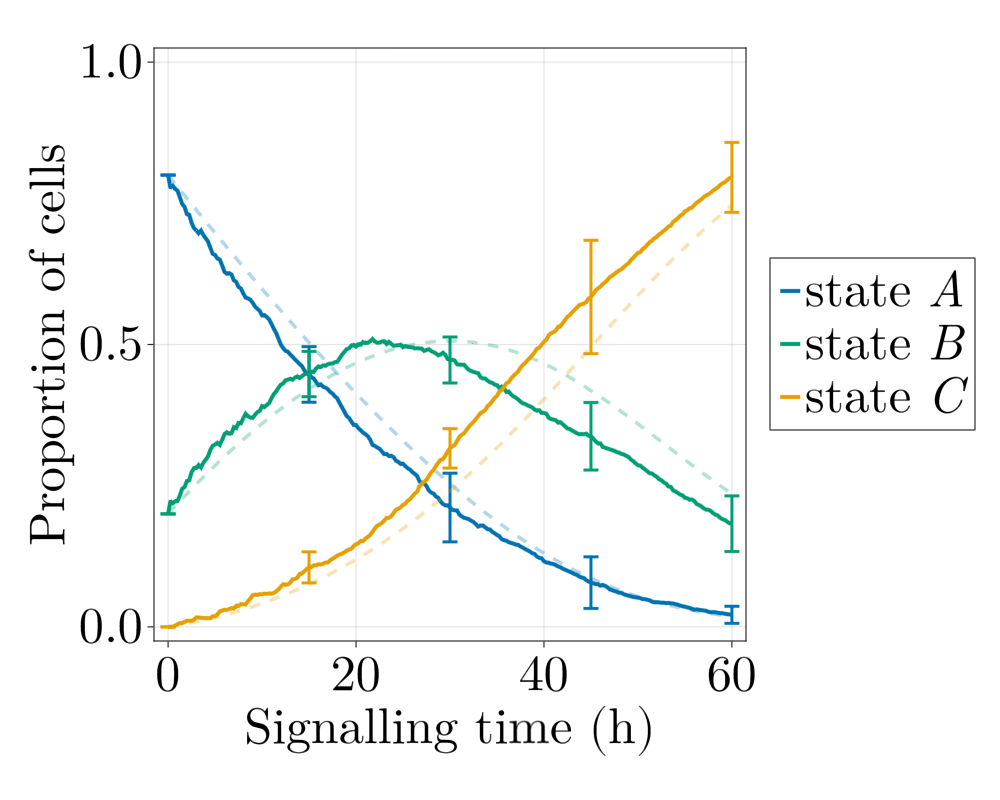

GLMakie.Screen(...)

In [15]:
plot_proportions_vs_meanfield_std(com, color_map, m1, m2, 
    avgprop, std=stdprop, k=parameters[:k])

# Proportions over time for b = 0.2, adh = 5, 1.4prolifB = prolifA,C

## Model

In [ ]:
model = ABM(3,

	# Global parameters
	model = Dict(
		# Mechanics
		:range => Float64,
		:mu => Float64,
		:lambda => Float64,
		:adh => Array{Float64},
		:rep => Float64,
		:fp => Float64,
		:kp_on => Float64,
		:kp_off => Float64,
		# Division
		:tau_div => Float64,
		:sigma_div => Float64,
		:olap => Float64,
		:g_on => Bool,
		# Differentiation
		:d_on => Bool,
		:b => Float64,
		:p => Float64,
		:q => Float64,
		:k => Float64,
		# Reference values
		:t0 => Float64,
		:r0 => Float64,
		:f0 => Float64,
	),


	# Agent parameters
	agent = Dict(
		:t_div => Float64,
		:ni => Int64,
		:cell_state => Int64,
		:r => Float64,
		# Mechanics
		:vx => Float64,
		:vy => Float64,
		:vz => Float64,
		:fx => Float64,
		:fy => Float64,
		:fz => Float64,
		# Protrusions
		:fpx => Float64,
		:fpy => Float64,
		:fpz => Float64,
		:marked => Bool,
		:t_paired => Float64,
		# Differentiation
		:ni_a => Float64,
		:r_ab => Float64,
		:r_bc => Float64,
	),


	# Mechanics
	agentODE = quote

		fx = 0
		fy = 0
		fz = 0
		ni = 0
		@loopOverNeighbors it2 begin
			dij = CBMMetrics.euclidean(x, x[it2], y, y[it2], z, z[it2])
			# Passive forces
			if dij < mu * 2 * r && dij > 0
				if dij < 2 * r
					fx += rep * adh[cell_state, cell_state[it2]] * (2 * r / dij - 1) * (mu * 2 * r / dij - 1) * (x - x[it2]) / dij
					fy += rep * adh[cell_state, cell_state[it2]] * (2 * r / dij - 1) * (mu * 2 * r / dij - 1) * (y - y[it2]) / dij
					fz += rep * adh[cell_state, cell_state[it2]] * (2 * r / dij - 1) * (mu * 2 * r / dij - 1) * (z - z[it2]) / dij
				else
					fx += adh[cell_state, cell_state[it2]] * (2 * r / dij - 1) * (mu * 2 * r / dij - 1) * (x - x[it2]) / dij
					fy += adh[cell_state, cell_state[it2]] * (2 * r / dij - 1) * (mu * 2 * r / dij - 1) * (y - y[it2]) / dij
					fz += adh[cell_state, cell_state[it2]] * (2 * r / dij - 1) * (mu * 2 * r / dij - 1) * (z - z[it2]) / dij
				end
			end
			# Counting neighbours
			if dij < range * 2 * r
				ni += 1
			end
		end

		# Protrusion active forces
		if marked == true
			if t < t_paired
				fx += fpx
				fy += fpy
				fz += fpz
			else
				marked = false
			end
		end

		# Equations of motion
		vx = fx / lambda
		vy = fy / lambda
		vz = fz / lambda
		dt(x) = vx
		dt(y) = vy
		dt(z) = vz

	end,


	# Growth and differentiation
	agentRule = quote
		# Growth
		if g_on
			if t > t_div
				x_div = CBMDistributions.normal(0, 1)
				y_div = CBMDistributions.normal(0, 1)
				z_div = CBMDistributions.normal(0, 1)
				norm_div = sqrt(x_div^2 + y_div^2 + z_div^2)
				x_div /= norm_div
				y_div /= norm_div
				z_div /= norm_div

				r_sep = r * olap
                if cell_state == 2
                    prolif = tau_div/1.4
                else
                    prolif = tau_div
                end
				@addAgent(
					x = x + r_sep * x_div,
					y = y + r_sep * y_div,
					z = z + r_sep * z_div,
					vx = vx / 2,
					vy = vy / 2,
					vz = vz / 2,
					t_div = t + CBMDistributions.uniform(prolif * (1 - sigma_div), prolif * (1 + sigma_div))
				)
				@addAgent(
					x = x - r_sep * x_div,
					y = y - r_sep * y_div,
					z = z - r_sep * z_div,
					vx = vx / 2,
					vy = vy / 2,
					vz = vz / 2,
					t_div = t + CBMDistributions.uniform(prolif * (1 - sigma_div), prolif * (1 + sigma_div))
				)
				@removeAgent()
			end
		end

		# Differentiation
		if d_on == true && cell_state != 3
			ni = 0
			ni_a = 0
			@loopOverNeighbors it2 begin
				dij = CBMMetrics.euclidean(x, x[it2], y, y[it2], z, z[it2])
				if dij < range * 2 * r
					ni += 1
					if (cell_state[it2] == 1)
						ni_a += 1
					end
				end
			end

			if ni != 0
				ni_a /= ni
			end

			ran = CBMDistributions.uniform(0, 1)

			if cell_state == 1
				r_ab = p / (1 + k * ni_a)
				if ran < r_ab * dt
					cell_state = 2
				end

			elseif cell_state == 2
				r_bc = q / (1 + k * ni_a)
				if ran < r_bc * dt
					cell_state = 3
				end
			end
		end

	end, 
	
	
	agentAlg = CBMIntegrators.Heun(),
);


## Initialization

In [ ]:
parameters = define_par();
dt = 0.002;
save_each = round(Int64, 0.25 / dt);

Random.seed!(2345)
n_cells = 60;

In [ ]:
ite  = 7
tf = 30;

In [ ]:
com = initialize_growth(parameters; dt=dt);
grow_size!(com, save_each, n_cells)
m0 = length(com);
println(formed_correctly(com))

In [ ]:
growncom = deepcopy(com);

## Proportions over time

In [ ]:
com_aux = deepcopy(growncom);

In [ ]:
adh  = 5
com.adh = [1 1 1; 1 adh 1; 1 1 1];
setfield!(com_aux,:dt, 0.001);
com_aux.tau_div = 10;

fp = 5
kp_on = 20
kp_off = 10
true
Plot 1: timestamp 114
Plot 2: timestamp 194
Plot 3: timestamp 274
Plot 4: timestamp 354


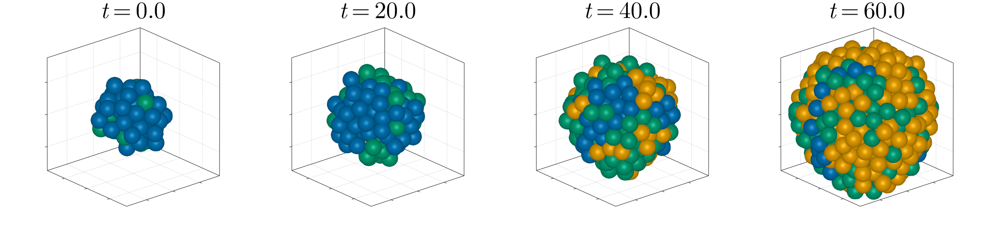

Plot 1: timestamp 114
Plot 2: timestamp 194
Plot 3: timestamp 274
Plot 4: timestamp 354


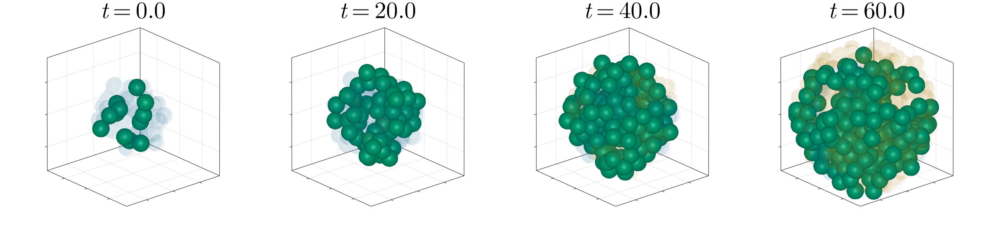

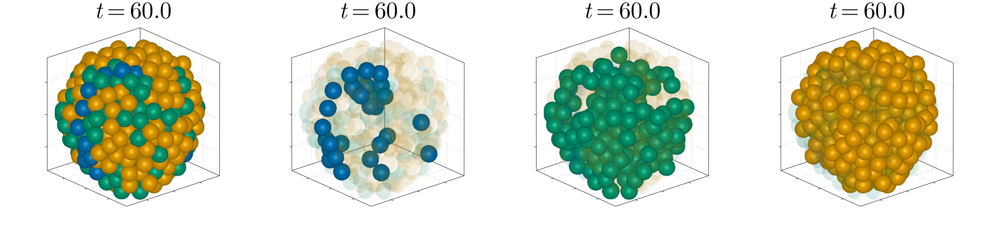

GLMakie.Screen(...)

In [20]:
	Random.seed!(1234)

	com = deepcopy(com_aux)
	initialize_diff!(com, g_on = true)
    global m1 = length(com)
    
	differentiate_growing!(com, save_each, tf, fp=5)
    println(formed_correctly(com))
	global m2 = length(com)

    dimensionalize_com!(com)

    plot_aggregate(com, color_map, m1, m2, size=35, shownumbers=false, showtime = true)
    plot_state(com, color_map, m1, m2; state=2,size=35, shownumbers=false, showtime = true)
    plot_state_timestamp(com, color_map, m2, size=35, showtime = true, shownumbers=false)

### Loop

In [ ]:
Random.seed!(1234)
seeds = rand(1:2000, ite)
props_bprolif = Dict();

Seed 1/7 = 652 ...fp = 5
kp_on = 20
kp_off = 10
true
Plot 1: timestamp 114
Plot 2: timestamp 194
Plot 3: timestamp 274
Plot 4: timestamp 354


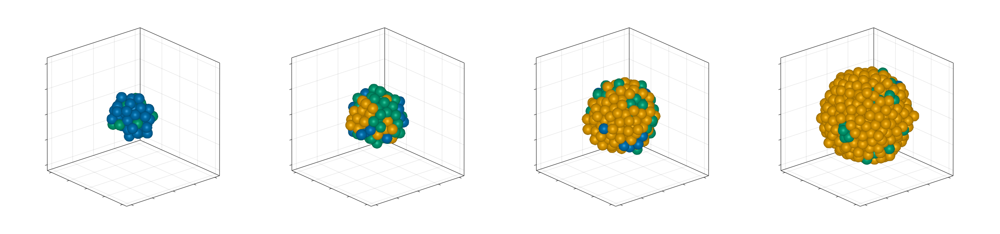

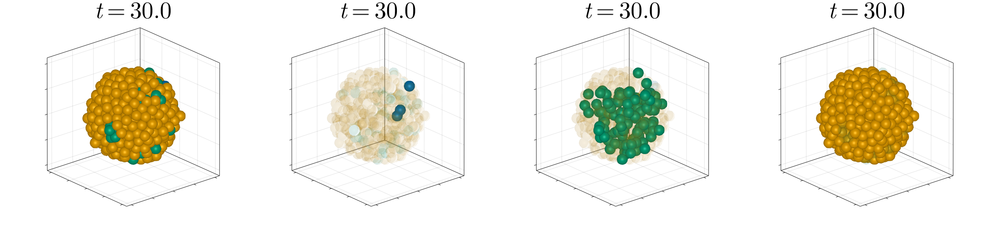

Seed 2/7 = 1099 ...fp = 5
kp_on = 20
kp_off = 10
true
Plot 1: timestamp 114
Plot 2: timestamp 194
Plot 3: timestamp 274
Plot 4: timestamp 354


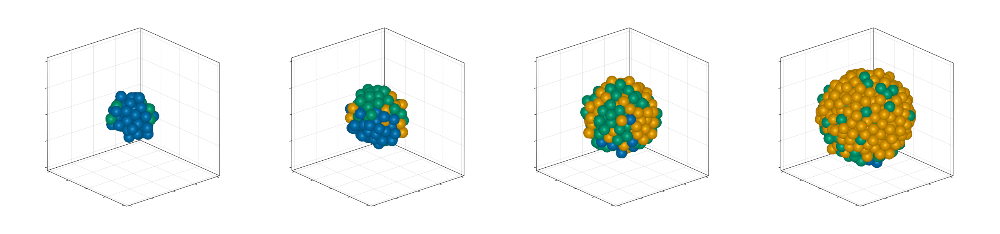

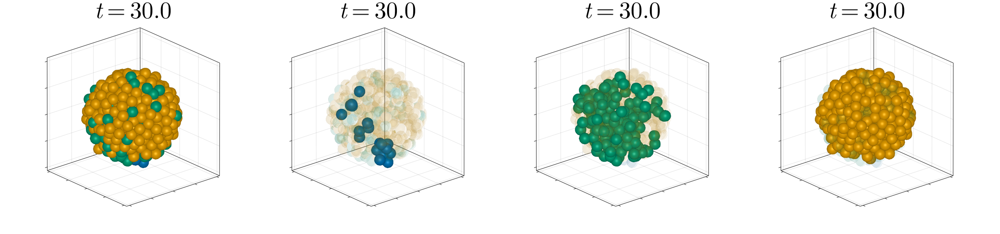

Seed 3/7 = 438 ...fp = 5
kp_on = 20
kp_off = 10
true
Plot 1: timestamp 114
Plot 2: timestamp 194
Plot 3: timestamp 274
Plot 4: timestamp 354


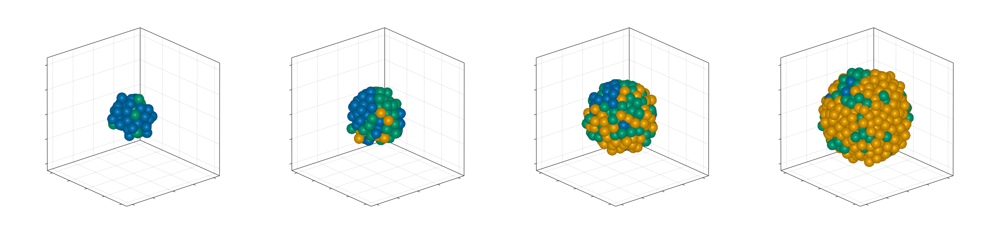

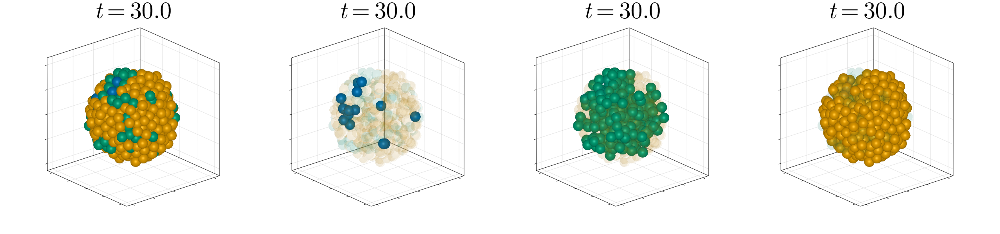

Seed 4/7 = 1789 ...fp = 5
kp_on = 20
kp_off = 10
true
Plot 1: timestamp 114
Plot 2: timestamp 194
Plot 3: timestamp 274
Plot 4: timestamp 354


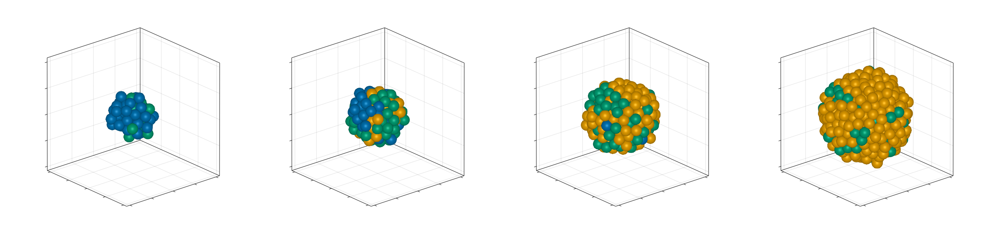

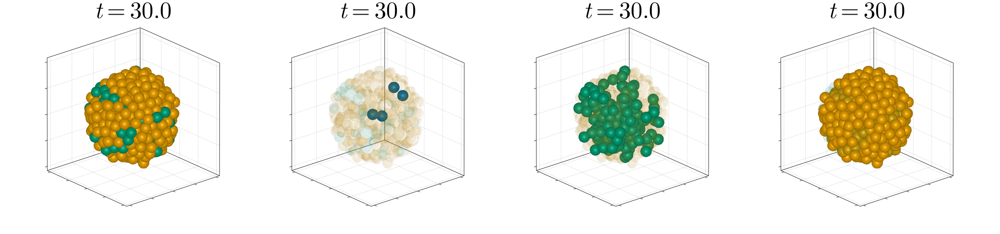

Seed 5/7 = 707 ...fp = 5
kp_on = 20
kp_off = 10
true
Plot 1: timestamp 114
Plot 2: timestamp 194
Plot 3: timestamp 274
Plot 4: timestamp 354


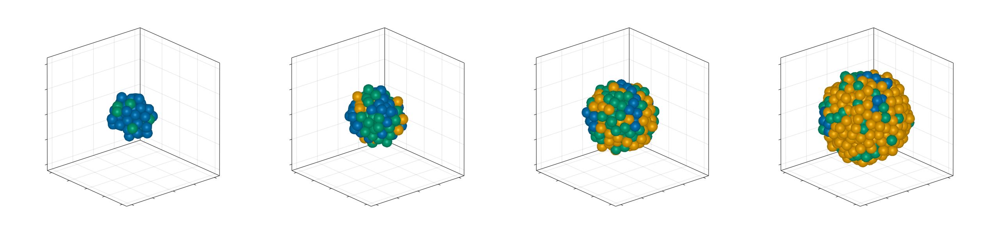

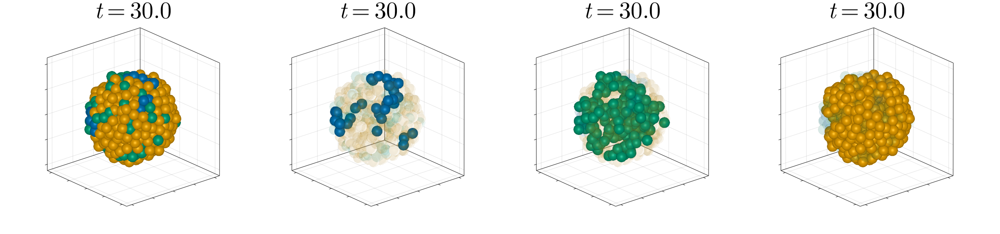

Seed 6/7 = 789 ...fp = 5
kp_on = 20
kp_off = 10
true
Plot 1: timestamp 114
Plot 2: timestamp 194
Plot 3: timestamp 274
Plot 4: timestamp 354


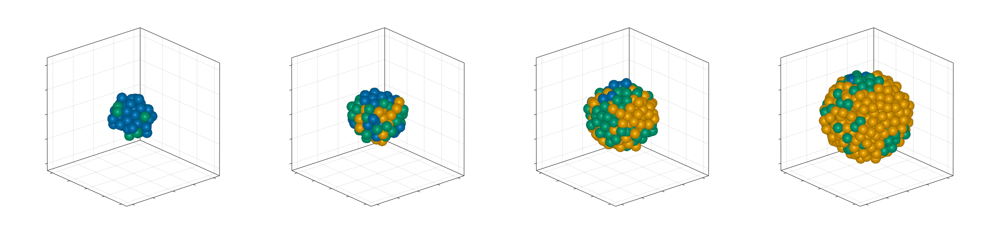

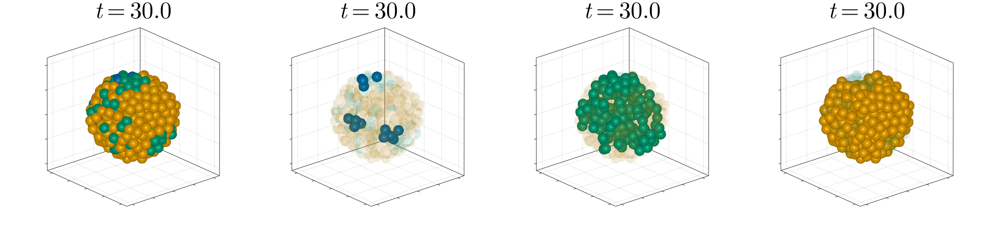

Seed 7/7 = 1907 ...fp = 5
kp_on = 20
kp_off = 10
true
Plot 1: timestamp 114
Plot 2: timestamp 194
Plot 3: timestamp 274
Plot 4: timestamp 354


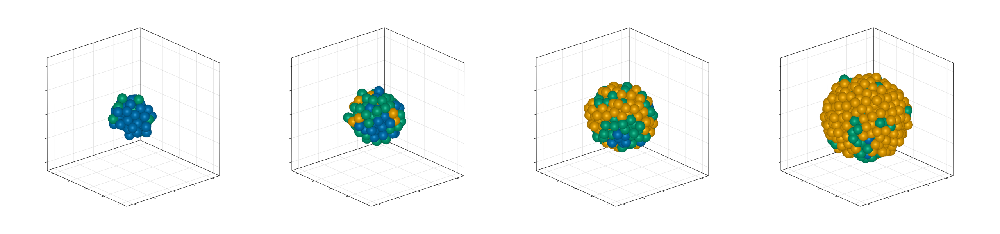

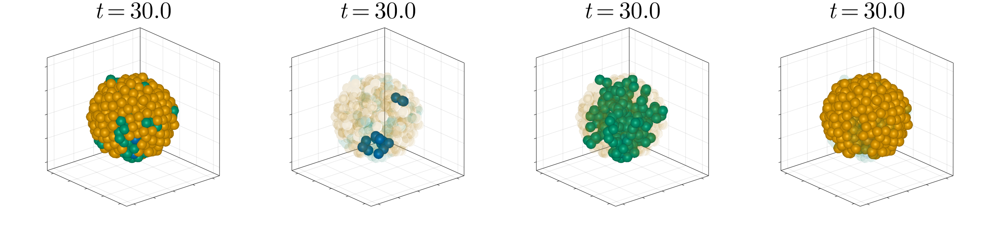

7

In [12]:
bad = 0
for i in 1:ite
	seed = seeds[i]
	print("Seed $i/$ite = $seed ...")
	Random.seed!(seed)

	com = deepcopy(com_aux)
	initialize_diff!(com, g_on = true)
    global m1 = length(com)
    
	differentiate_growing!(com, save_each, tf, fp=5)
    println(formed_correctly(com))
	global m2 = length(com)

    if !formed_correctly(com)
    	plot_aggregate(com, color_map, m1, m2)
        bad += 1
        continue
    end 
    
    plot_aggregate(com, color_map, m1, m2, shownumbers=false)
    # plot_state(com, color_map, m1, m2; state=2, shownumbers=false)
    plot_state_timestamp(com, color_map, m2, showtime = true, shownumbers=false)
	props_bprolif[i-bad] = get_props(com)
    # plot_proportions_vs_meanfield(com, color_map, m1, m2, props[i])
end
ite -= bad

### Plot comparison

In [ ]:
dimensionalize_com!(com)

In [ ]:
# avgprop = [mean(props[i][state][1:329] for i in 1:ite) for state in 1:3]
# stdprop = [std([props[i][state][1:329] for i in 1:ite]) for state in 1:3]

In [ ]:
avgprop_bprolif = avg_props_new(com, props_bprolif, ite);
stdprop_bprolif = std_props(com, props_bprolif, ite);

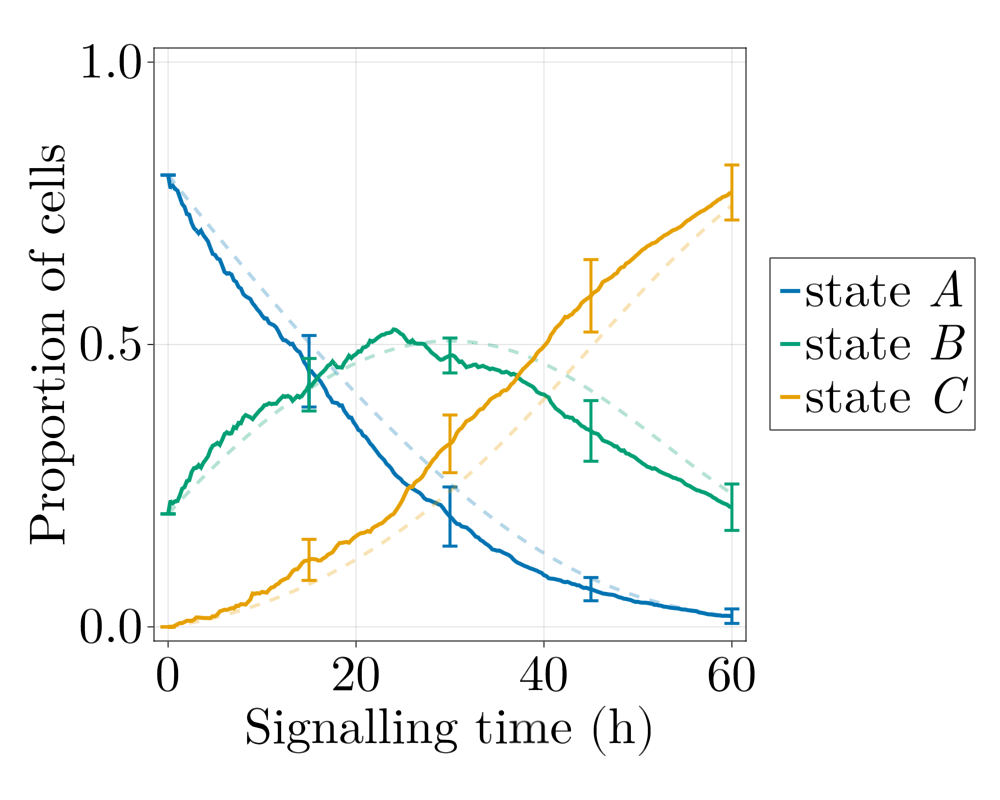

GLMakie.Screen(...)

In [16]:
plot_proportions_vs_meanfield_std(com, color_map, m1, m2, 
    avgprop_bprolif, std=stdprop_bprolif, k=parameters[:k])

# Proportions over time for b = 0.2, adh = 5, 1.4prolifA = prolifB,C

## Model

In [ ]:
model = ABM(3,

	# Global parameters
	model = Dict(
		# Mechanics
		:range => Float64,
		:mu => Float64,
		:lambda => Float64,
		:adh => Array{Float64},
		:rep => Float64,
		:fp => Float64,
		:kp_on => Float64,
		:kp_off => Float64,
		# Division
		:tau_div => Float64,
		:sigma_div => Float64,
		:olap => Float64,
		:g_on => Bool,
		# Differentiation
		:d_on => Bool,
		:b => Float64,
		:p => Float64,
		:q => Float64,
		:k => Float64,
		# Reference values
		:t0 => Float64,
		:r0 => Float64,
		:f0 => Float64,
	),


	# Agent parameters
	agent = Dict(
		:t_div => Float64,
		:ni => Int64,
		:cell_state => Int64,
		:r => Float64,
		# Mechanics
		:vx => Float64,
		:vy => Float64,
		:vz => Float64,
		:fx => Float64,
		:fy => Float64,
		:fz => Float64,
		# Protrusions
		:fpx => Float64,
		:fpy => Float64,
		:fpz => Float64,
		:marked => Bool,
		:t_paired => Float64,
		# Differentiation
		:ni_a => Float64,
		:r_ab => Float64,
		:r_bc => Float64,
	),


	# Mechanics
	agentODE = quote

		fx = 0
		fy = 0
		fz = 0
		ni = 0
		@loopOverNeighbors it2 begin
			dij = CBMMetrics.euclidean(x, x[it2], y, y[it2], z, z[it2])
			# Passive forces
			if dij < mu * 2 * r && dij > 0
				if dij < 2 * r
					fx += rep * adh[cell_state, cell_state[it2]] * (2 * r / dij - 1) * (mu * 2 * r / dij - 1) * (x - x[it2]) / dij
					fy += rep * adh[cell_state, cell_state[it2]] * (2 * r / dij - 1) * (mu * 2 * r / dij - 1) * (y - y[it2]) / dij
					fz += rep * adh[cell_state, cell_state[it2]] * (2 * r / dij - 1) * (mu * 2 * r / dij - 1) * (z - z[it2]) / dij
				else
					fx += adh[cell_state, cell_state[it2]] * (2 * r / dij - 1) * (mu * 2 * r / dij - 1) * (x - x[it2]) / dij
					fy += adh[cell_state, cell_state[it2]] * (2 * r / dij - 1) * (mu * 2 * r / dij - 1) * (y - y[it2]) / dij
					fz += adh[cell_state, cell_state[it2]] * (2 * r / dij - 1) * (mu * 2 * r / dij - 1) * (z - z[it2]) / dij
				end
			end
			# Counting neighbours
			if dij < range * 2 * r
				ni += 1
			end
		end

		# Protrusion active forces
		if marked == true
			if t < t_paired
				fx += fpx
				fy += fpy
				fz += fpz
			else
				marked = false
			end
		end

		# Equations of motion
		vx = fx / lambda
		vy = fy / lambda
		vz = fz / lambda
		dt(x) = vx
		dt(y) = vy
		dt(z) = vz

	end,


	# Growth and differentiation
	agentRule = quote
		# Growth
		if g_on
			if t > t_div
				x_div = CBMDistributions.normal(0, 1)
				y_div = CBMDistributions.normal(0, 1)
				z_div = CBMDistributions.normal(0, 1)
				norm_div = sqrt(x_div^2 + y_div^2 + z_div^2)
				x_div /= norm_div
				y_div /= norm_div
				z_div /= norm_div

				r_sep = r * olap
                if cell_state == 1
                    prolif = tau_div/1.4
                else
                    prolif = tau_div
                end
				@addAgent(
					x = x + r_sep * x_div,
					y = y + r_sep * y_div,
					z = z + r_sep * z_div,
					vx = vx / 2,
					vy = vy / 2,
					vz = vz / 2,
					t_div = t + CBMDistributions.uniform(prolif * (1 - sigma_div), prolif * (1 + sigma_div))
				)
				@addAgent(
					x = x - r_sep * x_div,
					y = y - r_sep * y_div,
					z = z - r_sep * z_div,
					vx = vx / 2,
					vy = vy / 2,
					vz = vz / 2,
					t_div = t + CBMDistributions.uniform(prolif * (1 - sigma_div), prolif * (1 + sigma_div))
				)
				@removeAgent()
			end
		end

		# Differentiation
		if d_on == true && cell_state != 3
			ni = 0
			ni_a = 0
			@loopOverNeighbors it2 begin
				dij = CBMMetrics.euclidean(x, x[it2], y, y[it2], z, z[it2])
				if dij < range * 2 * r
					ni += 1
					if (cell_state[it2] == 1)
						ni_a += 1
					end
				end
			end

			if ni != 0
				ni_a /= ni
			end

			ran = CBMDistributions.uniform(0, 1)

			if cell_state == 1
				r_ab = p / (1 + k * ni_a)
				if ran < r_ab * dt
					cell_state = 2
				end

			elseif cell_state == 2
				r_bc = q / (1 + k * ni_a)
				if ran < r_bc * dt
					cell_state = 3
				end
			end
		end

	end, 
	
	
	agentAlg = CBMIntegrators.Heun(),
);


## Initialization

In [ ]:
parameters = define_par();
dt = 0.002;
save_each = round(Int64, 0.25 / dt);

Random.seed!(2345)
n_cells = 60;

In [ ]:
ite  = 7
tf = 30;

In [ ]:
com = initialize_growth(parameters; dt=dt);
grow_size!(com, save_each, n_cells)
m0 = length(com);
println(formed_correctly(com))

In [ ]:
growncom = deepcopy(com);

## Proportions over time

In [ ]:
com_aux = deepcopy(growncom);

In [ ]:
adh  = 5
com.adh = [1 1 1; 1 adh 1; 1 1 1];
setfield!(com_aux,:dt, 0.001);
com_aux.tau_div = 10;

fp = 5
kp_on = 20
kp_off = 10
true
Plot 1: timestamp 84
Plot 2: timestamp 164
Plot 3: timestamp 244
Plot 4: timestamp 324


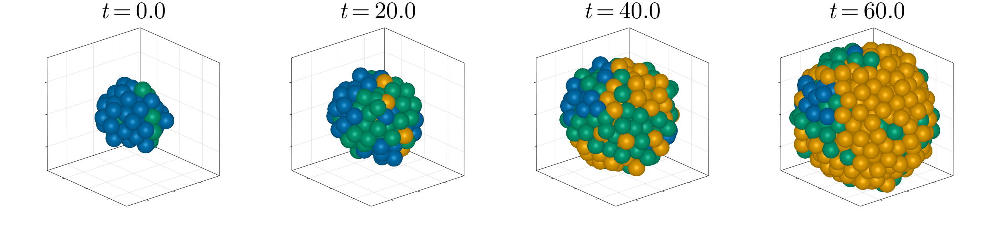

Plot 1: timestamp 84
Plot 2: timestamp 164
Plot 3: timestamp 244
Plot 4: timestamp 324


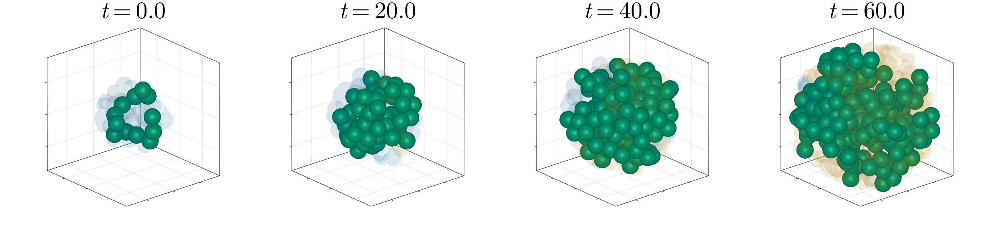

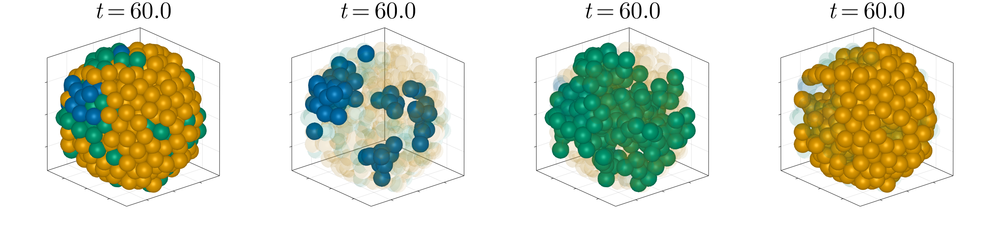

GLMakie.Screen(...)

In [28]:
	Random.seed!(1234)

	com = deepcopy(com_aux)
	initialize_diff!(com, g_on = true)
    global m1 = length(com)
    
	differentiate_growing!(com, save_each, tf, fp=5)
    println(formed_correctly(com))
	global m2 = length(com)

    dimensionalize_com!(com)

    plot_aggregate(com, color_map, m1, m2, size=35, shownumbers=false, showtime = true)
    plot_state(com, color_map, m1, m2; state=2,size=35, shownumbers=false, showtime = true)
    plot_state_timestamp(com, color_map, m2, size=35, showtime = true, shownumbers=false)

### Loop

In [ ]:
Random.seed!(1234)
seeds = rand(1:2000, ite)
props_aprolif = Dict();

Seed 1/7 = 652 ...fp = 5
kp_on = 20
kp_off = 10
true
Plot 1: timestamp 84
Plot 2: timestamp 164
Plot 3: timestamp 244
Plot 4: timestamp 324


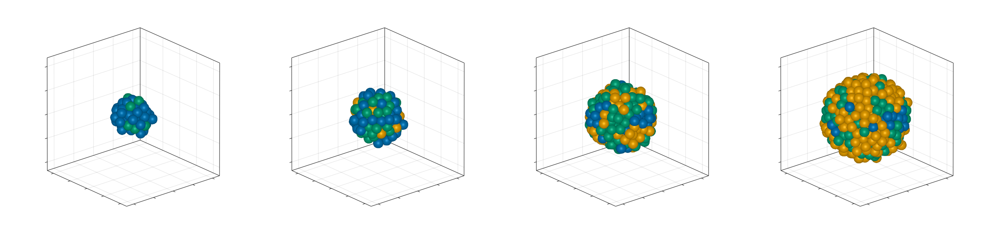

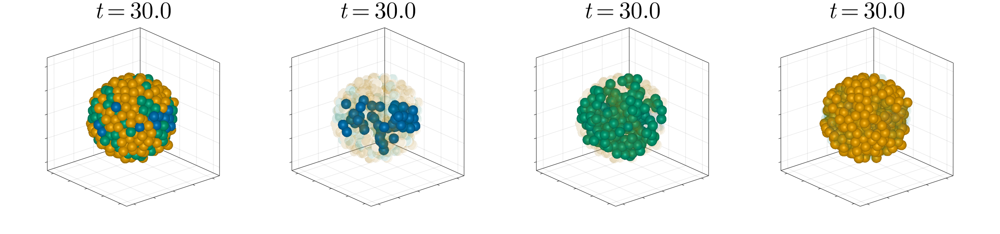

Seed 2/7 = 1099 ...fp = 5
kp_on = 20
kp_off = 10
true
Plot 1: timestamp 84
Plot 2: timestamp 164
Plot 3: timestamp 244
Plot 4: timestamp 324


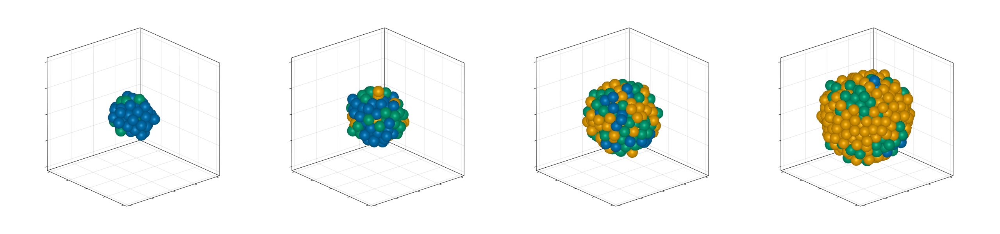

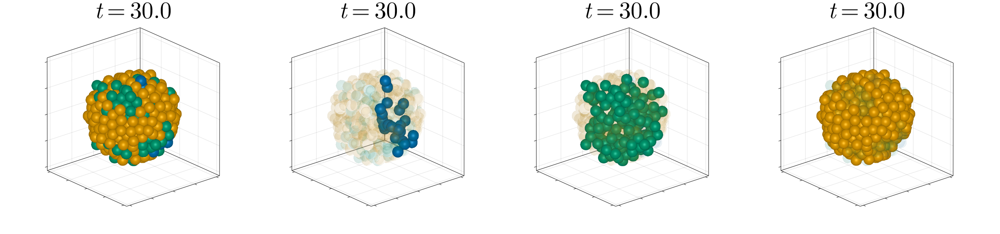

Seed 3/7 = 438 ...fp = 5
kp_on = 20
kp_off = 10
true
Plot 1: timestamp 84
Plot 2: timestamp 164
Plot 3: timestamp 244
Plot 4: timestamp 324


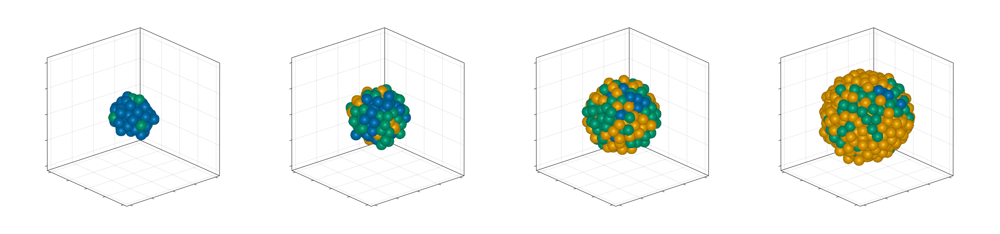

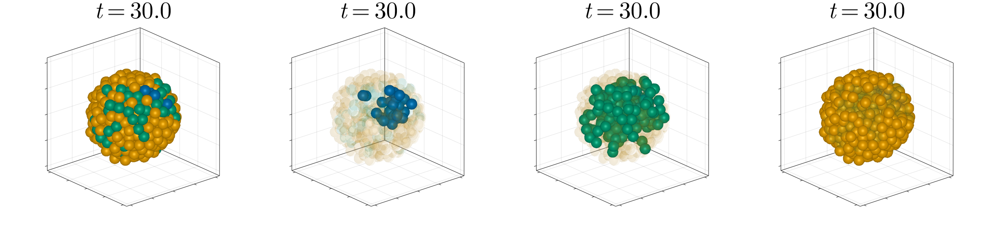

Seed 4/7 = 1789 ...fp = 5
kp_on = 20
kp_off = 10
true
Plot 1: timestamp 84
Plot 2: timestamp 164
Plot 3: timestamp 244
Plot 4: timestamp 324


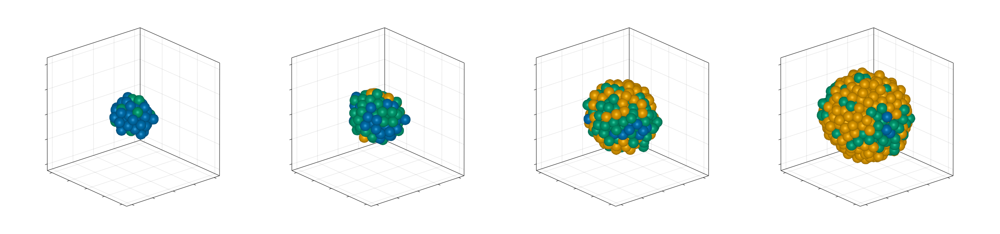

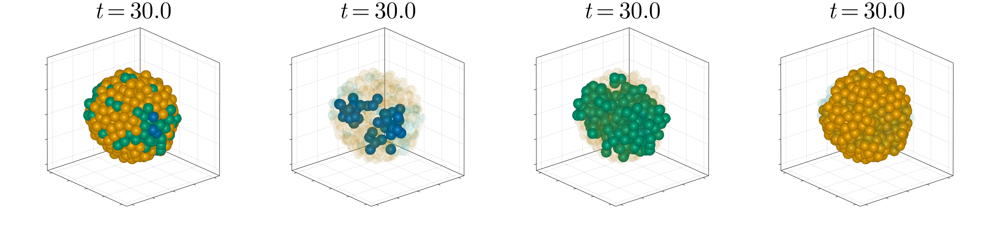

Seed 5/7 = 707 ...fp = 5
kp_on = 20
kp_off = 10
true
Plot 1: timestamp 84
Plot 2: timestamp 164
Plot 3: timestamp 244
Plot 4: timestamp 324


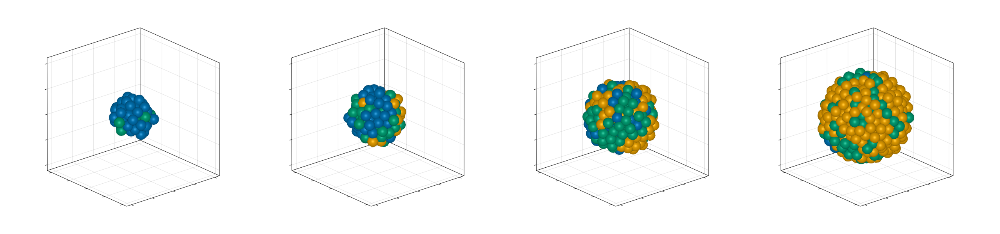

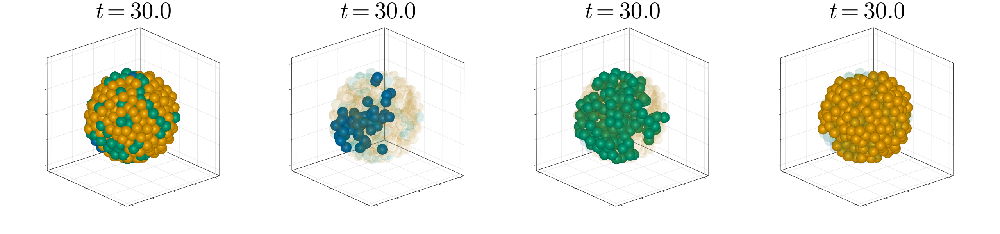

Seed 6/7 = 789 ...fp = 5
kp_on = 20
kp_off = 10
true
Plot 1: timestamp 84
Plot 2: timestamp 164
Plot 3: timestamp 244
Plot 4: timestamp 324


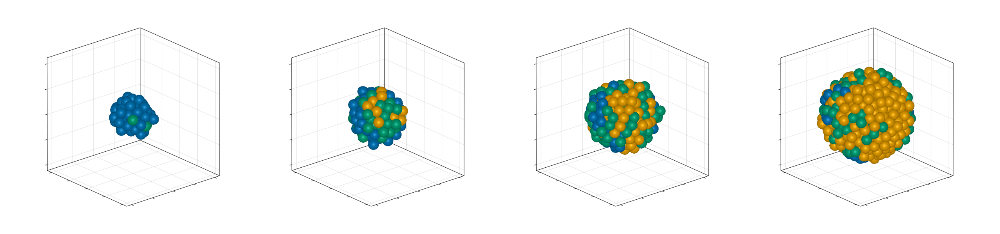

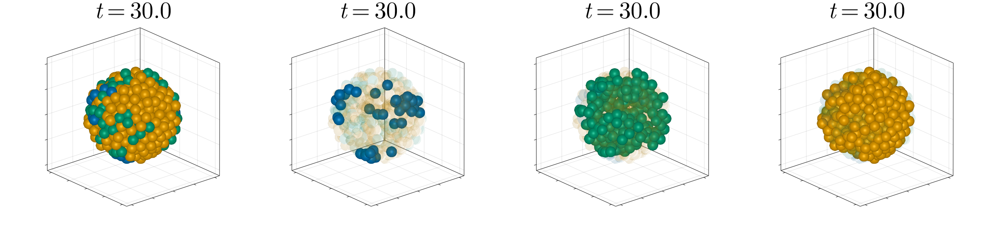

Seed 7/7 = 1907 ...fp = 5
kp_on = 20
kp_off = 10
true
Plot 1: timestamp 84
Plot 2: timestamp 164
Plot 3: timestamp 244
Plot 4: timestamp 324


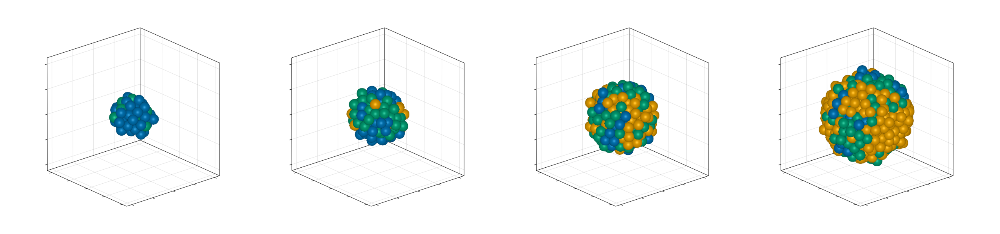

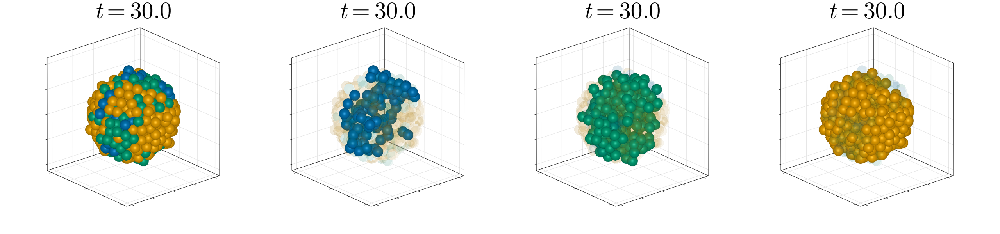

7

In [25]:
bad = 0
for i in 1:ite
	seed = seeds[i]
	print("Seed $i/$ite = $seed ...")
	Random.seed!(seed)

	com = deepcopy(com_aux)
	initialize_diff!(com, g_on = true)
    global m1 = length(com)
    
	differentiate_growing!(com, save_each, tf, fp=5)
    println(formed_correctly(com))
	global m2 = length(com)

    if !formed_correctly(com)
    	plot_aggregate(com, color_map, m1, m2)
        bad += 1
        continue
    end 
    
    plot_aggregate(com, color_map, m1, m2, shownumbers=false)
    # plot_state(com, color_map, m1, m2; state=2, shownumbers=false)
    plot_state_timestamp(com, color_map, m2, showtime = true, shownumbers=false)
	props_aprolif[i-bad] = get_props(com)
    # plot_proportions_vs_meanfield(com, color_map, m1, m2, props[i])
end
ite -= bad

### Plot comparison

In [ ]:
dimensionalize_com!(com)

In [ ]:
time_limit = 300

In [ ]:
avgprop_aprolif = [mean(props_aprolif[i][state][1:time_limit] for i in 1:ite) for state in 1:3]
stdprop_aprolif = [std([props_aprolif[i][state][1:time_limit] for i in 1:ite]) for state in 1:3]

In [ ]:
avgprop_aprolif = avg_props_new(com, props_aprolif, ite);
stdprop_aprolif = std_props(com, props_aprolif, ite);

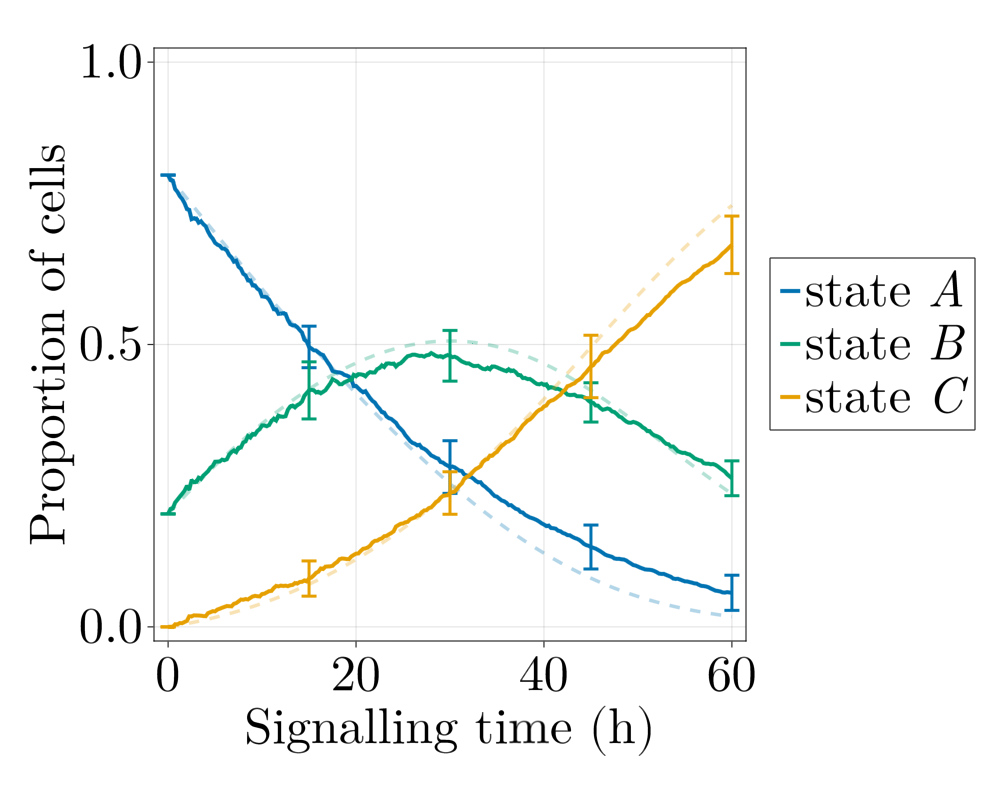

GLMakie.Screen(...)

In [29]:
plot_proportions_vs_meanfield_std(com, color_map, m1, m2, 
    avgprop_aprolif, std=stdprop_aprolif, k=parameters[:k])